In [ ]:
import torch
import torchvision
import torchvision.transforms as transforms
from torch.utils.data import Subset

# Define a transform to convert the images to tensors
transform = transforms.Compose([
    transforms.ToTensor()
])

# Download the MNIST training dataset
mnist_dataset = torchvision.datasets.MNIST(
    root='./data',
    train=True,
    download=True,
    transform=transform
)

# Print the size of the original dataset
print(f"Original MNIST dataset size: {len(mnist_dataset)} samples")


100%|██████████| 9.91M/9.91M [00:00<00:00, 44.7MB/s]
100%|██████████| 28.9k/28.9k [00:00<00:00, 1.24MB/s]
100%|██████████| 1.65M/1.65M [00:00<00:00, 11.2MB/s]
100%|██████████| 4.54k/4.54k [00:00<00:00, 8.26MB/s]

Original MNIST dataset size: 60000 samples


In [ ]:
# Create a subset of 1,000 samples
subset_size = 1000
indices = torch.randperm(len(mnist_dataset))[:subset_size]
mnist_subset = Subset(mnist_dataset, indices)

# Print the size of the subset
print(f"MNIST subset size: {len(mnist_subset)} samples")


MNIST subset size: 1000 samples


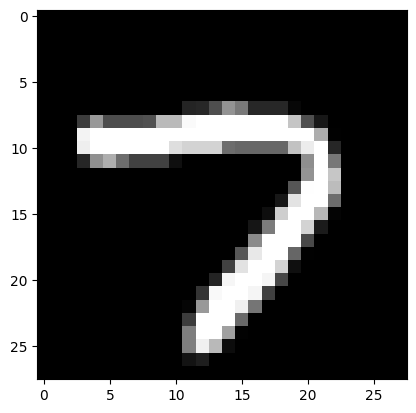

torch.Size([28, 28])


In [ ]:
import matplotlib.pyplot as plt
plt.imshow(mnist_subset[0][0][0], cmap='gray')
plt.show()
print(mnist_subset[0][0][0].shape)

AttributeError: module 'torch' has no attribute 'shape'

In [ ]:
print(mnist_subset[0][])

IndexError: tuple index out of range

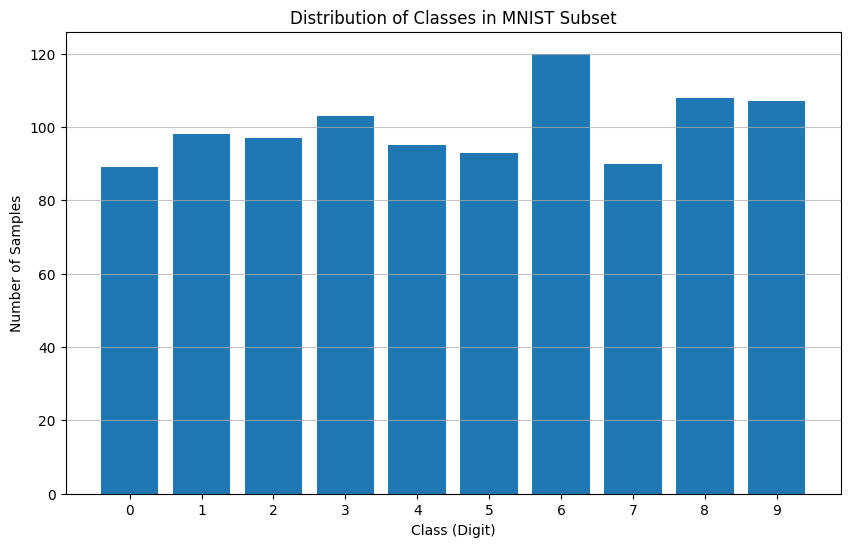

In [ ]:
import matplotlib.pyplot as plt

# Extract labels from the subset
labels = [label for _, label in mnist_subset]

# Create a histogram of the labels
plt.figure(figsize=(10, 6))
plt.hist(labels, bins=range(11), align='left', rwidth=0.8)
plt.xticks(range(10))
plt.title('Distribution of Classes in MNIST Subset')
plt.xlabel('Class (Digit)')
plt.ylabel('Number of Samples')
plt.grid(axis='y', alpha=0.75)
plt.show()

In [ ]:
# Install einops if not already installed
# try:
#     import einops
# except ImportError:
!pip install einops
import einops


In [ ]:
import torch
import einops

# Assuming mnist_subset is already defined and contains 1000 samples
# Each sample in mnist_subset is (image_tensor, label)
# where image_tensor has shape [1, 28, 28]

# Collect all images from the subset into a list
all_images = [img for img, _ in mnist_subset]

# Stack them into a single tensor
# This will result in a tensor of shape (1000, 1, 28, 28)
stacked_images = torch.stack(all_images)
print(f"Shape of stacked images before batching: {stacked_images.shape}")

# Define batch size
batch_size = 25

# Use einops.rearrange to create batches
# The pattern (b s) c h w -> b s c h w means:
#   (b s): the total number of samples (1000) is split into 'b' batches of 's' samples each
#   c: channel dimension (1)
#   h: height (28)
#   w: width (28)
batched_images = einops.rearrange(stacked_images, '(b s) c h w -> b s c h w', s=batch_size)

print(f"Shape of batched images: {batched_images.shape}")


Shape of stacked images before batching: torch.Size([1000, 1, 28, 28])
Shape of batched images: torch.Size([40, 25, 1, 28, 28])


In [ ]:
import random
# print random integer range 1000
rnd = random.randint(0,1000)
print(rnd)
data_to_plot = mnist_subset[rnd][0][0]
print(data_to_plot)

63
tensor([[0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0

(28, 28)
[[0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.        ]
 [0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.        ]
 [0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.        ]
 [0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.      

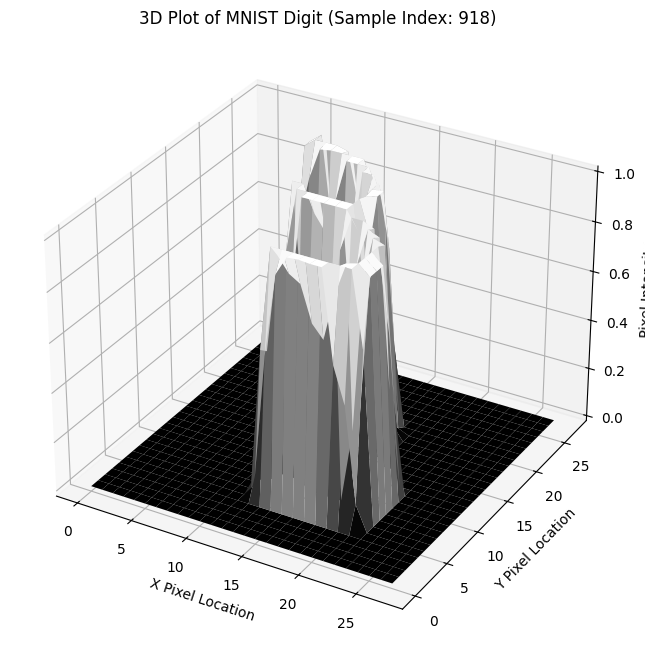

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import random
import numpy as np

# Generate a random index to select an image from the subset
random_index = random.randint(0, len(mnist_subset) - 1)

# Get the random image tensor (removing the channel dimension if present)
# The image is expected to be [1, 28, 28], so we take [0] to get [28, 28]
image_tensor = mnist_subset[random_index][0][0]

# Convert the image tensor to a NumPy array for plotting
image_array = image_tensor.numpy()

# Create a meshgrid for the x and y coordinates (pixel locations)
x = np.arange(0, image_array.shape[1], 1)
y = np.arange(0, image_array.shape[0], 1)
X, Y = np.meshgrid(x, y)

# The pixel intensity will be the z-axis
Z = image_array
print(Z.shape)
print(Z)

# Create the 3D plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot the surface
ax.plot_surface(X, Y, Z, cmap='gray')

# Set labels
ax.set_xlabel('X Pixel Location')
ax.set_ylabel('Y Pixel Location')
ax.set_zlabel('Pixel Intensity')
ax.set_title(f'3D Plot of MNIST Digit (Sample Index: {random_index})')

plt.show()


question 2 goes here for temp data https://github.com/LuisM78/Appliances-energy-prediction-data/blob/master/energydata_complete.csv

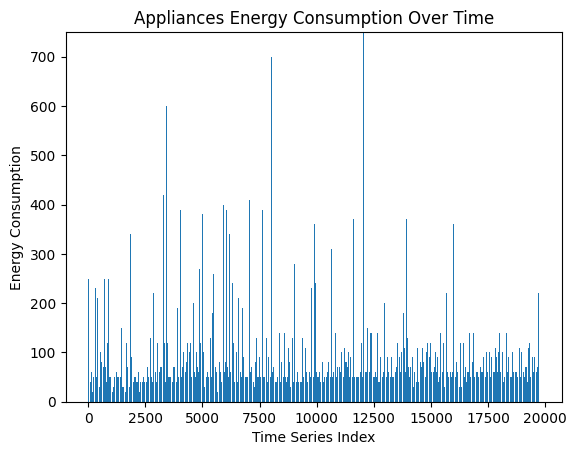

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
# df = pd.read_csv('https://github.com/LuisM78/Appliances-energy-prediction-data/blob/master/energydata_complete.csv')
df = pd.read_csv('energydata_complete.csv')
# df.head()
# df.columns.to_list()
# print(df.shape)
# df.Appliances
plt.bar(df.index, df.Appliances)
plt.xlabel('Time Series Index')
plt.ylabel('Energy Consumption')
plt.ylim(0, 750)
plt.title('Appliances Energy Consumption Over Time')
plt.show()

In [ ]:
df.head()
# Convert 'date' column to datetime objects for proper date comparison
df['date'] = pd.to_datetime(df['date'])

# Filter the DataFrame for the specific date '2016-01-12'
# .dt.date extracts only the date part for comparison
filtered_data = df[df['date'].dt.date == pd.to_datetime('2016-01-12').date()]

print(filtered_data.head())

SyntaxError: leading zeros in decimal integer literals are not permitted; use an 0o prefix for octal integers (ipython-input-3172767512.py, line 2)

In [ ]:
# Ensure the 'date' column is in datetime format
# This step was already done in a previous cell, but it's good practice to ensure it.
df['date'] = pd.to_datetime(df['date'])

# Define the start date for your one-week slice
# For example, let's pick January 18, 2016 (a Monday in the dataset)
start_date = pd.to_datetime('2016-01-18')

# Calculate the end date by adding 7 days to the start date
end_date = start_date + pd.Timedelta(days=7)

# Filter the DataFrame to get data for that one week
one_week_data = df[(df['date'] >= start_date) & (df['date'] < end_date)]

print(f"Data from {start_date.strftime('%Y-%m-%d')} to {end_date.strftime('%Y-%m-%d')} ({len(one_week_data)} samples):")
print(one_week_data.head())

In [ ]:
# You can also check the last few rows to confirm the date range
# print(one_week_data.tail())
df.date.iloc[10]

'2016-01-11 18:40:00'

Index([42], dtype='int64')
Index([1050], dtype='int64')


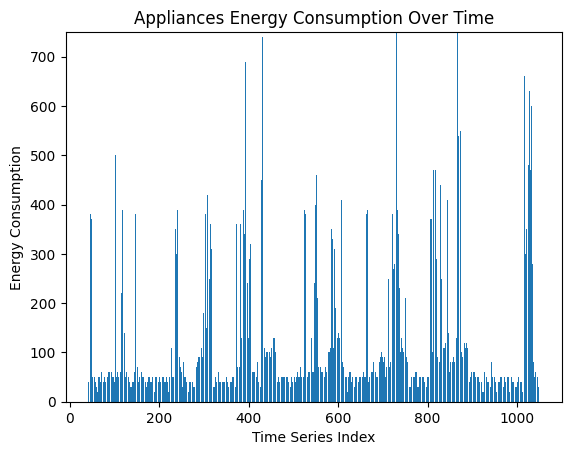

In [ ]:
#start date
start_day_idx = df.index[df['date'] == '2016-01-12 00:00:00']
end_day_idx = df.index[df.date == '2016-01-19 00:00:00']
print(start_day_idx)
print(end_day_idx)
# df.iloc[start_day_idx-1]
# df.iloc[end_day_idx]
week_slice = df.iloc[start_day_idx[0]:end_day_idx[0]]
# week_slice.tail()
plt.bar(week_slice.index, week_slice.Appliances)
plt.xlabel('Time Series Index')
plt.ylabel('Energy Consumption')
plt.ylim(0, 750)
plt.title('Appliances Energy Consumption Over Time')
plt.show()

In [ ]:
# we need to slice the df every 6 counts
import numpy as np
# Ensure 'date' column is datetime type before using .dt accessor
print(type(df.date[0]))
df['date'] = pd.to_datetime(df['date'])
df['day_of_week'] = df['date'].dt.day_name()
display(df.head())
week_slice = df.iloc[start_day_idx[0]:end_day_idx[0]]
# week_slice.date = pd.to_datetime(week_slice.date)
# week_slice = week_slice.set_index('date')
# hourly_data = week_slice.resample('H').mean()
week_slice['date'] = week_slice['date'].dt.strftime('%Y-%m-%d %H:%M:%S')
hourly_week_slice = week_slice.groupby(np.arange(len(week_slice)) // 6).sum()
hourly_week_slice.reset_index(inplace= True)
hourly_week_slice.head()
# hourly_week_slice.shape

# Resample to 60-minute (1-hour) intervals and calculate the mean
# hourly_data = df.resample('60Min').mean()

# plt.imshow(hourly_week_slice, cmap='viridis')

<class 'pandas._libs.tslibs.timestamps.Timestamp'>


,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,day_of_week
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433,Monday
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195,Monday
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668,Monday
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389,Monday
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097,Monday


/tmp/ipython-input-995467170.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  week_slice['date'] = week_slice['date'].dt.strftime('%Y-%m-%d %H:%M:%S')


ValueError: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

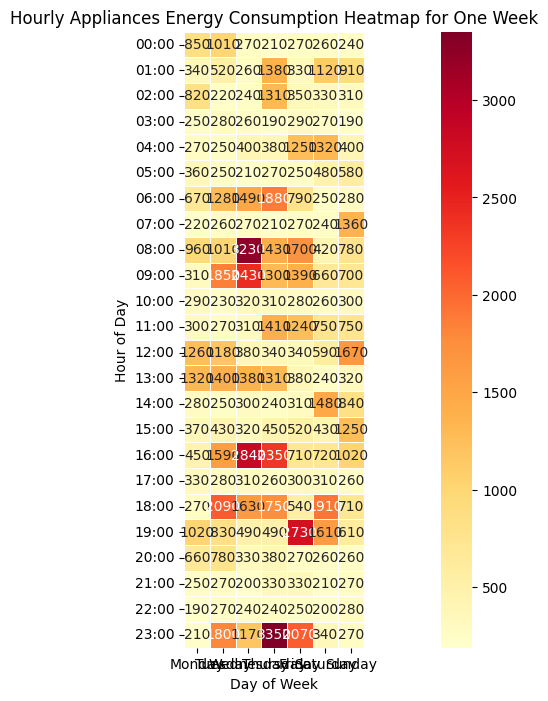

In [ ]:
from matplotlib import axis
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Extract the 'Appliances' consumption data
appliances_consumption = hourly_week_slice['Appliances']

# Reshape the data into a 7x24 matrix (7 days, 24 hours)
# Assuming the hourly_week_slice has 168 entries (7 days * 24 hours)
# The data is ordered chronologically, so the first 24 entries are day 1, next 24 are day 2, etc.
consumption_matrix = appliances_consumption.values.reshape(24, 7)

# Define day and hour labels
days_of_week = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
hours_of_day = [f'{h:02d}:00' for h in range(24)]

# Create the heatmap
fig, ax = plt.subplots(figsize=(15, 8))
# plt.figure(figsize=(15, 8))
sns.heatmap(
    consumption_matrix,
    xticklabels=days_of_week,
    yticklabels=hours_of_day,
    # cmap='viridis',
    cmap='YlOrRd',
    annot=True,
    fmt='.0f',
    linewidths=.5,
    ax = ax
)
ax.set_aspect('equal')
plt.title('Hourly Appliances Energy Consumption Heatmap for One Week')
plt.xlabel('Day of Week')
plt.ylabel('Hour of Day')
plt.show()

In [ ]:
# Calculate NSM (number of seconds from midnight)
df['NSM'] = df['date'].dt.hour * 3600 + df['date'].dt.minute * 60 + df['date'].dt.second

# Display the DataFrame with the new NSM column
display(df[['date', 'NSM', 'Appliances']].head())

,date,NSM,Appliances
0,2016-01-11 17:00:00,61200,60
1,2016-01-11 17:10:00,61800,60
2,2016-01-11 17:20:00,62400,50
3,2016-01-11 17:30:00,63000,50
4,2016-01-11 17:40:00,63600,60


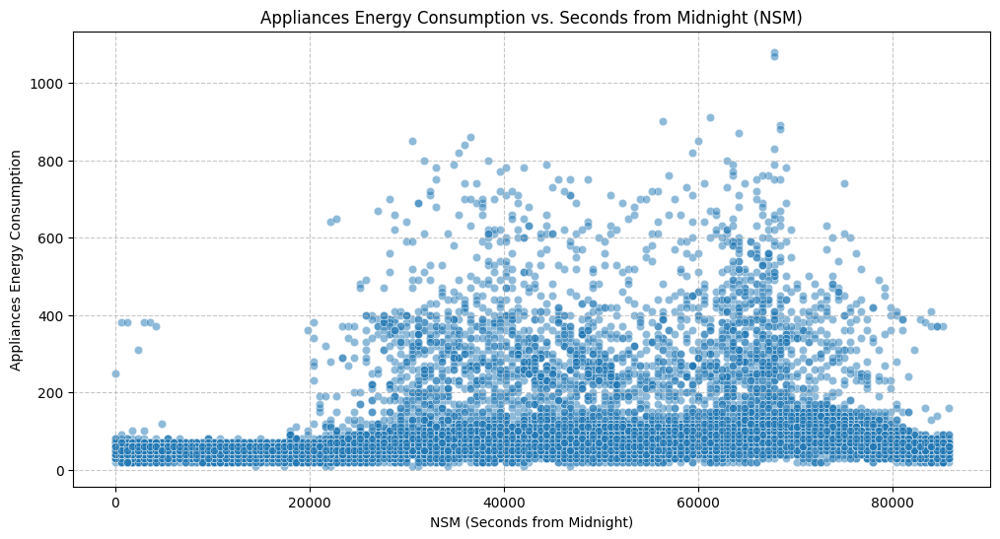

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot Energy Consumption vs. NSM
plt.figure(figsize=(12, 6))
sns.scatterplot(x='NSM', y='Appliances', data=df, alpha=0.5)
plt.title('Appliances Energy Consumption vs. Seconds from Midnight (NSM)')
plt.xlabel('NSM (Seconds from Midnight)')
plt.ylabel('Appliances Energy Consumption')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

In [ ]:
# NSM = df.NSM[0]
# Appliances = df.Appliances[0]
# print(NSM)
# print(Appliances)
# plot for only one day

61200
60


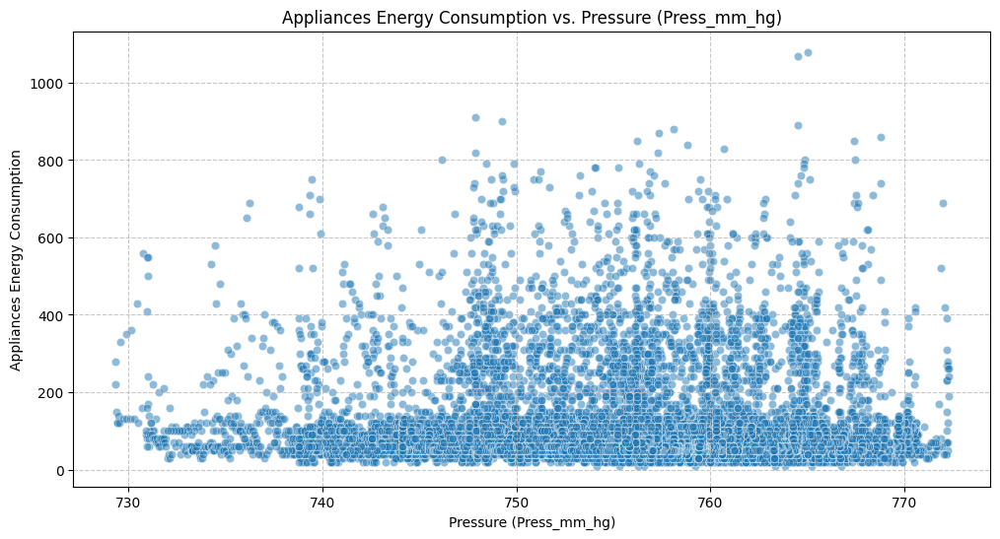

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot Appliances Energy Consumption vs. Press_mm_hg
plt.figure(figsize=(12, 6))
sns.scatterplot(x='Press_mm_hg', y='Appliances', data=df, alpha=0.5)
plt.title('Appliances Energy Consumption vs. Pressure (Press_mm_hg)')
plt.xlabel('Pressure (Press_mm_hg)')
plt.ylabel('Appliances Energy Consumption')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

In [ ]:
import pandas as pd

# Calculate the Pearson correlation between 'Appliances' and 'NSM'
correlation_nsm = df['Appliances'].corr(df['NSM'])
print(f"Pearson Correlation between Appliances and NSM: {correlation_nsm:.3f}")

# Calculate the Pearson correlation between 'Appliances' and 'Press_mm_hg'
correlation_press = df['Appliances'].corr(df['Press_mm_hg'])
print(f"Pearson Correlation between Appliances and Press_mm_hg: {correlation_press:.3f}")

Pearson Correlation between Appliances and NSM: 0.217
Pearson Correlation between Appliances and Press_mm_hg: -0.035


A correlation coefficient close to +1 indicates a strong positive linear relationship, close to -1 indicates a strong negative linear relationship, and close to 0 indicates a weak or no linear relationship. These values quantify the strength and direction of the observed relationships in the scatter plots.

Q2

In [ ]:
import pandas as pd
airfoil = pd.read_csv('airfoil_self_noise.dat', sep='\t', header=None)
airfoil.head()

,0,1,2,3,4,5
0,800,0.0,0.3048,71.3,0.002663,126.201
1,1000,0.0,0.3048,71.3,0.002663,125.201
2,1250,0.0,0.3048,71.3,0.002663,125.951
3,1600,0.0,0.3048,71.3,0.002663,127.591
4,2000,0.0,0.3048,71.3,0.002663,127.461


In [ ]:
mean_a = airfoil.mean(axis=0)
std_a = airfoil.std(axis=0)
med_a = airfoil.median(axis=0)
kurtosis = airfoil.kurtosis(axis=0)
skewness_a = airfoil.skew(axis=0)
range_a = airfoil.max(axis=0) - airfoil.min(axis=0)

print(mean_a)
# print(std_a)

0    2886.380572
1       6.782302
2       0.136548
3      50.860745
4       0.011140
5     124.835943
dtype: float64


In [21]:
import cv2 as cv
import numpy as np
import matplotlib
matplotlib.use('Agg')
import matplotlib.pyplot as plt
import os
import glob
import random
orig_image = cv.imread('/content/I1.png')
h, w = orig_image.shape[:2]  # height, width
ctr = (w // 2, h // 2)
ang = 30
scl = 1.0

mat = cv2.getRotationMatrix2D(ctr, ang, scl)
print(mat)

[[  0.8660254    0.5        -73.45636945]
 [ -0.5          0.8660254  111.85709707]]


8


array([[[31, 36, 40],
        [31, 35, 39],
        [31, 35, 39],
        ...,
        [35, 39, 41],
        [32, 38, 39],
        [30, 37, 38]],

       [[26, 37, 36],
        [28, 37, 36],
        [29, 37, 36],
        ...,
        [35, 39, 43],
        [33, 38, 41],
        [33, 39, 41]],

       [[31, 35, 37],
        [31, 34, 36],
        [31, 34, 36],
        ...,
        [35, 40, 42],
        [37, 40, 42],
        [38, 40, 43]],

       ...,

       [[43, 43, 46],
        [42, 42, 44],
        [40, 40, 42],
        ...,
        [28, 34, 43],
        [29, 34, 43],
        [30, 35, 43]],

       [[34, 35, 40],
        [35, 36, 40],
        [36, 37, 40],
        ...,
        [28, 35, 41],
        [30, 35, 41],
        [30, 34, 40]],

       [[31, 32, 38],
        [33, 34, 39],
        [34, 35, 40],
        ...,
        [30, 35, 39],
        [31, 36, 39],
        [30, 34, 37]]], dtype=uint8)
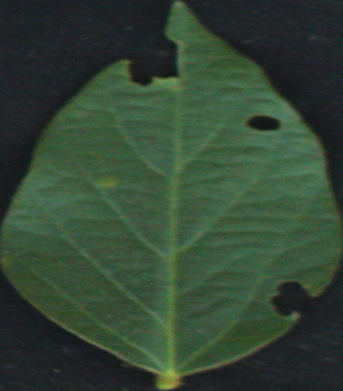

100


In [24]:
import cv2 as cv
import numpy as np
import matplotlib
matplotlib.use('Agg')
import matplotlib.pyplot as plt
import os
import glob

# Load all images
images = []
for i in range(1,9):
  img = cv.imread(f'/content/I{i}.png')
  img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
  images.append(img)


print(len(images))
display(images[1])

def rand_aug(orig_image):
  h, w = orig_image.shape[:2]  # height, width
  ctr = (w // 2, h // 2)
  # Rotate
  ang = random.randint(0,360)
  # Scale
  scl = random.uniform(1.0 , 1.4)
  # Shift (translate)
  dt_x = np.random.uniform(-0.1 * w, 0.1 * w)
  dt_y = np.random.uniform(-0.1 * h, 0.1 * h)
  # Make Rotation Matrix
  mat = cv2.getRotationMatrix2D(ctr, ang, scl)
  mat[0, 2] += dt_x
  mat[1, 2] += dt_y
  # Apply affine (rotate + scale + shift)
  rot_image = cv2.warpAffine(orig_image, mat, (w, h),
                          flags=cv2.INTER_LINEAR,
                          borderMode=cv2.BORDER_REFLECT_101)
 # Define grid, source and destination points for perspective warp
  rows, cols = 4, 4
  src_pts = np.float32([[c * w / (cols - 1), r * h / (rows - 1)]
                        for r in range(rows) for c in range(cols)])
  dst_pts = src_pts + np.random.uniform(-8, 8, src_pts.shape).astype(np.float32)
  # Warp perspective
  H, _ = cv2.findHomography(src_pts, dst_pts, method=0)
  output_image = cv2.warpPerspective(rot_image, H, (w, h),
                                flags=cv2.INTER_LINEAR,
                                borderMode=cv2.BORDER_REFLECT_101)

  output_image = np.clip(output_image, 0, 1)
  return output_image

augmented_images = []
for idx in range(100):
  img_idx = random.randint(0,7)
  aug_img = rand_aug(images[img_idx])
  augmented_images.append(aug_img)

print(len(augmented_images))
  # opr = random.randint(0,4)
  # print(opr)
  # if opr == 0:
    # rotate
    #rotation matrix
    # angle = random.randint(0,360)
    # print(angle)
    # cv.rotate command
  # elif opr == 1:
    # Shift or translate
    #translation matrix
    # tx = random.randint(-10,10)
    # ty = random.randint(-10,10)
    # cv translate command
  # elif opr == 2:
    # scale or resize
    # scale paramater
    # scale = random.uniform(0.8, 1.2)
    # cv resize command
  # elif opr == 3:
    # warp
    # warp paramater
    # warp = random.uniform(-0.1, 0.1)
    # cv warp command
  # elif opr == 4:
    # flip
    # flip paramater
    # flip = random.randint(0,1)

In [ ]:
# Make 64×64 patches

PATCH_SIZE = 64
image_patches = []
np.random.seed(0)

for img in augmented_images:
    h, w = img.shape[:2]
    for _ in range(len(augmented_images)):
        r = np.random.randint(0, h - PATCH_SIZE)
        c = np.random.randint(0, w - PATCH_SIZE)
        patch = img[r:r + PATCH_SIZE, c:c + PATCH_SIZE, :]
        image_patches.append(patch)

image_patches = np.array(image_patches)   # (N, 64, 64, 3)

# ─────────────────────────────────────────────
# 3. ZCA Whitening using cv2 + numpy
# ─────────────────────────────────────────────
N, ph, pw, pc = image_patches.shape
X = image_patches.reshape(N, -1).astype(np.float64)   # (N, D)
display(X)

# Mean-centre
mean = X.mean(axis=0)
X_c = X - mean

# Covariance
cov = np.cov(X_c, rowvar=False)
# U, S, Vt = np.linalg.svd(X_c, full_matrices=False)   # U:(N,N) S:(N,) Vt:(N,D)
U, S, Vt = np.linalg.svd(cov)
eps = 0.1
D_inv = np.diag(1.0 / np.sqrt((S ** 2) / N + eps))
W_zca = Vt.T @ D_inv @ Vt      # (D, D)
X_white = X_c @ W_zca          # (N, D)

patches_white = X_white.reshape(N, ph, pw, pc)
print("ZCA whitening complete")

# Save a few whitened patches using cv2
# for i in range(5):
#     wp = patches_white[i]
#     wp_norm = cv2.normalize(wp, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
#     wp_bgr = cv2.cvtColor(wp_norm, cv2.COLOR_RGB2BGR)
#     cv2.imwrite(f"{OUTPUT_DIR}/white_patch_{i}.png", wp_bgr)

array([[1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       ...,
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.]])

Computing ZCA whitening via SVD...


In [ ]:
# ─────────────────────────────────────────────
# 4 & 5. Channel-by-channel distributions
# ─────────────────────────────────────────────
channel_names = ['Red', 'Green', 'Blue']
colors = ['#e74c3c', '#27ae60', '#2980b9']

fig, axes = plt.subplots(2, 3, figsize=(15, 8))
fig.suptitle('Channel-by-Channel Distributions', fontsize=16, fontweight='bold')

for ch in range(3):
    orig_vals  = image_patches[:, :, :, ch].flatten()
    white_vals = patches_white[:, :, :, ch].flatten()

    # plot Original
    ax = axes[0, ch]
    ax.hist(orig_vals, bins=80, color=colors[ch], alpha=0.75, density=True)
    ax.set_title(f'Original – {channel_names[ch]} channel')
    ax.set_xlabel('Pixel value (0–1)')
    ax.set_ylabel('Density')
    ax.set_xlim(0, 1)
    mu, sigma = orig_vals.mean(), orig_vals.std()
    ax.text(0.05, 0.95, f'μ={mu:.3f}\nσ={sigma:.3f}',
            transform=ax.transAxes, va='top', fontsize=9,
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.7))

    # plot ZCA Whitened
    ax2 = axes[1, ch]
    ax2.hist(white_vals, bins=80, color=colors[ch], alpha=0.75, density=True)
    ax2.set_title(f'ZCA Whitened – {channel_names[ch]} channel')
    ax2.set_xlabel('Pixel value')
    ax2.set_ylabel('Density')
    mu2, sigma2 = white_vals.mean(), white_vals.std()
    ax2.text(0.05, 0.95, f'μ={mu2:.3f}\nσ={sigma2:.3f}',
             transform=ax2.transAxes, va='top', fontsize=9,
             bbox=dict(boxstyle='round', facecolor='white', alpha=0.7))

axes[0, 0].set_ylabel('Density (Original)',  fontsize=10)
axes[1, 0].set_ylabel('Density (Whitened)',  fontsize=10)

plt.tight_layout()
# plt.savefig(f"{OUTPUT_DIR}/channel_distributions.png", dpi=150, bbox_inches='tight')
# plt.close()
# print("Saved channel_distributions.png")

plt.show()

In [ ]:
# Write code to randomly rotate, shift, scale, and warp the image of the patches
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
import random

# make it a function
for patches in range(100):
  opr = random.randint(0,4)
  print(opr)
  if opr == 0:
    # rotate
    #rotation matrix
    angle = random.randint(0,360)
    print(angle)
    # cv.rotate command
  elif opr == 1:
    # Shift or translate
    #translation matrix
    tx = random.randint(-10,10)
    ty = random.randint(-10,10)
    # cv translate command
  elif opr == 2:
    # scale or resize
    # scale paramater
    scale = random.uniform(0.8, 1.2)
    # cv resize command
  elif opr == 3:
    # warp
    # warp paramater
    warp = random.uniform(-0.1, 0.1)
    # cv warp command
  elif opr == 4:
    # flip
    # flip paramater
    flip = random.randint(0,1)

#Obtain local patches (of a certain fixed size of your choice, much smaller than the
# original image size) from all the leaf images
#do the for loop and choose fixed resolution
fixed_size = 25 #pixels
#create batch

#use prewhiten algo

# Determine the channel-by-channel distribution of the prewhitened images





Question 4

In [ ]:


import cv2
import numpy as np
import os
import sys
from scipy import ndimage


# ── Tunable parameters ──────────────────────────────────────────────────────
HSV_LOWER = np.array([22, 25, 20])   # inclusive lower bound (H, S, V)
HSV_UPPER = np.array([97, 255, 255]) # inclusive upper bound

# A component is "background" if it covers more than this fraction of the image
MAX_BLOB_FRACTION = 0.04             # 4 % of total pixels

# Minimum blob area as a fraction of image (removes stray noise)
MIN_BLOB_FRACTION = 0.00005          # 0.005 % of total pixels

NUM_SUBPLOTS = 36
# ─────────────────────────────────────────────────────────────────────────────


def _green_mask(img: np.ndarray) -> np.ndarray:
    """Return a binary mask of green-vegetation pixels."""
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    return cv2.inRange(hsv, HSV_LOWER, HSV_UPPER)


def _morph_merge(mask: np.ndarray, h: int, w: int) -> np.ndarray:
    """
    Close intra-plant gaps and dilate to merge individual plants that
    belong to the same subplot into a single connected blob.
    The kernel sizes scale with image dimensions so the script works on
    images of different resolutions.
    """
    # Step 1 - remove tiny specks
    k_open = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, k_open, iterations=1)

    # Step 2 - close gaps within one plant
    sz_close = max(3, min(w, h) // 200)
    k_close = cv2.getStructuringElement(
        cv2.MORPH_ELLIPSE, (sz_close, sz_close))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, k_close, iterations=3)

    # Step 3 - dilate so plants of the same subplot merge
    sz_dil = max(7, min(w, h) // 70)
    k_dil = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (sz_dil, sz_dil))
    mask = cv2.dilate(mask, k_dil, iterations=2)

    # Step 4 - final closing pass
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, k_close, iterations=2)
    return mask


def _label_components(mask: np.ndarray, h: int, w: int):
    """
    Label connected components in *mask*, filter out background blobs
    (too large) and noise blobs (too small), then return the bounding
    boxes of the NUM_SUBPLOTS largest remaining components.
    """
    labeled, num_features = ndimage.label(mask)
    if num_features == 0:
        return []

    sizes = np.array(
        ndimage.sum(mask, labeled, range(1, num_features + 1)),
        dtype=float
    )

    total_px = float(h * w)
    max_area = MAX_BLOB_FRACTION * total_px * 255.0
    min_area = MIN_BLOB_FRACTION * total_px * 255.0

    valid = np.where((sizes <= max_area) & (sizes >= min_area))[0]
    if len(valid) == 0:
        # Fallback: relax size constraints and just take the largest components
        valid = np.arange(len(sizes))

    valid_labels = valid + 1           # ndimage labels start at 1
    valid_sizes  = sizes[valid]

    n_keep = min(NUM_SUBPLOTS, len(valid_labels))
    top_idx = valid_labels[np.argsort(valid_sizes)[::-1][:n_keep]]

    bboxes = []
    for label_id in top_idx:
        row_mask = np.any(labeled == label_id, axis=1)
        col_mask = np.any(labeled == label_id, axis=0)
        rows = np.where(row_mask)[0]
        cols = np.where(col_mask)[0]
        if len(rows) == 0 or len(cols) == 0:
            continue
        x1, x2 = int(cols[0]), int(cols[-1])
        y1, y2 = int(rows[0]), int(rows[-1])
        bboxes.append((x1, y1, x2 - x1, y2 - y1))

    return bboxes


def _sort_reading_order(bboxes, h: int):
    """
    Sort bounding boxes in reading order (rows top-to-bottom,
    columns left-to-right).  Row membership is decided by an adaptive
    threshold derived from the largest gaps between consecutive y-centres.
    """
    if not bboxes:
        return bboxes

    # Sort roughly by y centre
    bboxes_s = sorted(bboxes, key=lambda b: b[1] + b[3] // 2)
    y_cents = np.array([b[1] + b[3] // 2 for b in bboxes_s], dtype=float)

    if len(y_cents) < 2:
        return bboxes_s

    diffs = np.diff(y_cents)

    # We expect ~6 rows for 36 plots, so there should be ~5 large inter-row gaps.
    n_rows_expected = max(2, int(round(NUM_SUBPLOTS ** 0.5)))
    sorted_diffs = np.sort(diffs)[::-1]
    inter_row_gap_min = sorted_diffs[
        min(n_rows_expected - 1, len(sorted_diffs) - 1)]
    # Any gap >= half the smallest inter-row gap starts a new row
    thr = max(inter_row_gap_min * 0.5, h // 20)

    rows_grouped = []
    cur_row = [bboxes_s[0]]
    for i in range(1, len(bboxes_s)):
        if diffs[i - 1] >= thr:
            rows_grouped.append(sorted(cur_row, key=lambda b: b[0]))
            cur_row = [bboxes_s[i]]
        else:
            cur_row.append(bboxes_s[i])
    rows_grouped.append(sorted(cur_row, key=lambda b: b[0]))

    return [b for row in rows_grouped for b in row]


def segment_subplots(image_path: str,
                     output_path: str = None,
                     debug: bool = False):

    img = cv2.imread(image_path)
    if img is None:
        raise FileNotFoundError(f"Cannot open image: {image_path}")

    h, w = img.shape[:2]

    # 1. Green mask
    mask = _green_mask(img)

    # 2. Morphological merging
    mask_merged = _morph_merge(mask, h, w)

    if debug and output_path:
        cv2.imwrite(output_path.replace(".jpg", "_dbg_mask.jpg"), mask_merged)

    # 3. Connected components -> bounding boxes
    bboxes = _label_components(mask_merged, h, w)

    if not bboxes:
        print(f"  WARNING: No plant blobs detected in {image_path}")
        return img, []

    # 4. Sort in reading order
    bboxes_ordered = _sort_reading_order(bboxes, h)

    # 5. Draw annotations
    annotated  = img.copy()
    font       = cv2.FONT_HERSHEY_SIMPLEX
    font_scale = max(0.45, w / 2200)
    thickness  = max(2, w // 400)
    box_color  = (0, 0, 255)     # red
    txt_color  = (0, 0, 255)     # red
    bg_color   = (255, 255, 255) # white background for readability

    for idx, (x, y, bw, bh) in enumerate(bboxes_ordered, start=1):
        # Bounding box
        cv2.rectangle(annotated, (x, y), (x + bw, y + bh),
                      box_color, thickness)

        # Text label
        label = str(idx)
        (tw, th), baseline = cv2.getTextSize(label, font, font_scale, thickness)
        tx, ty = x, y
        # White backing rectangle
        cv2.rectangle(annotated,
                      (tx, ty - th - baseline - 2),
                      (tx + tw + 2, ty),
                      bg_color, -1)
        cv2.putText(annotated, label,
                    (tx + 1, ty - baseline // 2 - 1),
                    font, font_scale, txt_color, thickness, cv2.LINE_AA)

    if output_path:
        cv2.imwrite(output_path, annotated)
        print(f"  [OK] {os.path.basename(image_path)} "
              f"-> {len(bboxes_ordered)} subplots found  ->  {output_path}")

    return annotated, bboxes_ordered


def process_directory(input_dir: str, output_dir: str):
    """Process all JPG/PNG images in *input_dir* and write to *output_dir*."""
    os.makedirs(output_dir, exist_ok=True)
    exts = {".jpg", ".jpeg", ".png"}
    files = sorted(
        f for f in os.listdir(input_dir)
        if os.path.splitext(f)[1].lower() in exts
    )
    if not files:
        print(f"No images found in '{input_dir}'")
        return
    for fname in files:
        in_path  = os.path.join(input_dir, fname)
        base     = os.path.splitext(fname)[0]
        out_path = os.path.join(output_dir, f"{base}_annotated.jpg")
        print(f"Processing: {fname}")
        try:
            segment_subplots(in_path, out_path)
        except Exception as exc:
            print(f"  ERROR: {exc}")


# ── Entry point
if __name__ == "__main__":
    if len(sys.argv) == 3:
        arg1, arg2 = sys.argv[1], sys.argv[2]
        if os.path.isdir(arg1):
            process_directory(arg1, arg2)
        else:
            print(f"Processing single image: {arg1}")
            segment_subplots(arg1, arg2)
    elif len(sys.argv) == 2:
        arg1 = sys.argv[1]
        if os.path.isdir(arg1):
            process_directory(arg1, "output")
        else:
            base, _ = os.path.splitext(arg1)
            segment_subplots(arg1, base + "_annotated.jpg")
    else:
        # Default: current directory -> ./output/
        process_directory(".", "output")

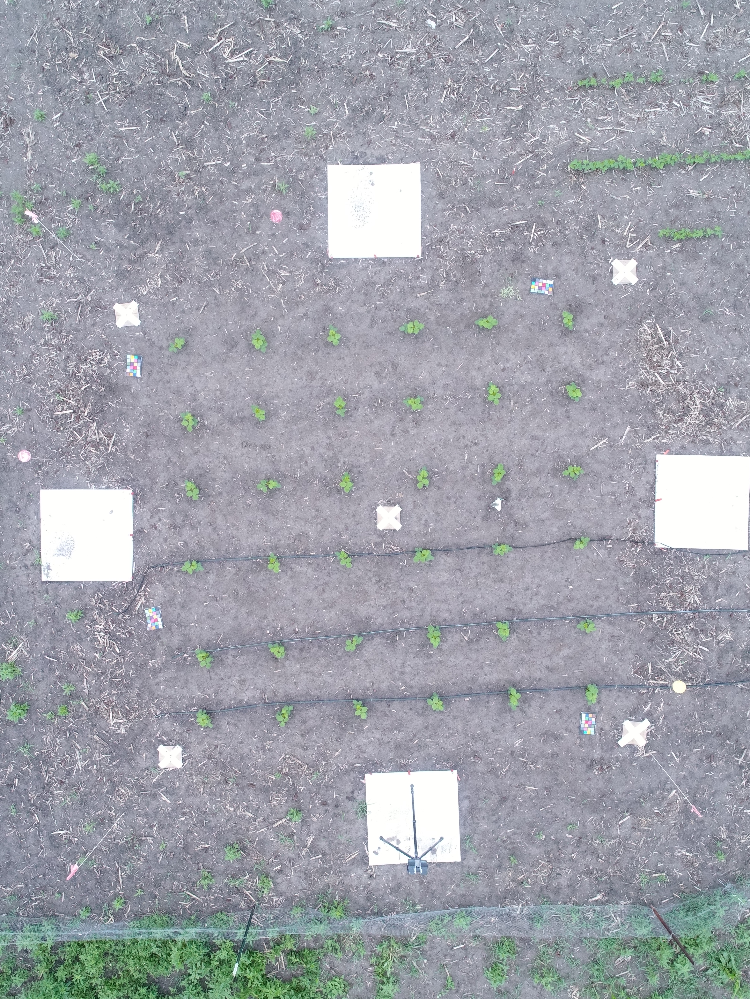

In [ ]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
import random
import scipy.stats as stats
import scipy
from google.colab.patches import cv2_imshow
#
sample_image = cv.imread('1.JPG')
# cv2_imshow(sample_image)
hsv_image = cv.cvtColor(sample_image, cv.COLOR_BGR2HSV)

# Define a specific BGR color (e.g., pure green)
pure_green_bgr = np.uint8([[[0, 255, 0]]])

# Convert it to HSV
hsv_green = cv.cvtColor(pure_green_bgr, cv.COLOR_BGR2HSV)

# Convert white to HSV
pure_white_bgr = np.uint8([[[255, 255, 255]]])
hsv_white = cv.cvtColor(pure_white_bgr, cv.COLOR_BGR2HSV)
# print(pure_white_bgr)
# [255, 255, 255]
# print("HSV value for pure green:", hsv_green)
# [[[ 60 255 255]]]
landmark_mask = cv.inRange(hsv_image, np.array([0, 0, 255-1]), np.array([255-10, 0, 255]))

white_squares = cv.bitwise_and(sample_image, sample_image, mask=landmark_mask)
cv2_imshow(sample_image)

# General green color range
# lower_green = np.array([36, 50, 70]) # Example from Stack Overflow and TutorialsPoint
# upper_green = np.array([89, 255, 255]) # Example from Stack Overflow and TutorialsPoint
lower_green = np.array([ 60-20, 50, 80]) # Example from Stack Overflow and TutorialsPoint
upper_green = np.array([ 60+20, 255, 255]) # Example from Stack Overflow and TutorialsPoint
# The mask will have white pixels where the color is within the range, and black otherwise.
mask = cv.inRange(hsv_image, lower_green, upper_green)
# This will show only the green parts of the original image.
result = cv.bitwise_and(sample_image, sample_image, mask=mask)
# cv2_imshow(sample_image)
# cv2_imshow(mask)
# cv2_imshow(result)
